## Step 12: Box and Whiskers graphs before removal of outliers

## What is a Box and Whiskers Plot?

A box and whiskers plot (or boxplot) is a standardized way of displaying the distribution of data based on a five-number summary:
1. **Minimum**: The smallest value (excluding outliers)
2. **First Quartile (Q1)**: The 25th percentile
3. **Median (Q2)**: The 50th percentile
4. **Third Quartile (Q3)**: The 75th percentile
5. **Maximum**: The largest value (excluding outliers)

Additional elements:
- **Box**: Represents the Interquartile Range (IQR = Q3 - Q1)
- **Whiskers**: Extend to the most extreme data points not considered outliers
- **Outliers**: Individual points plotted beyond the whiskers

## Why Use Box and Whiskers Plots?

1. **Distribution Visualization**:
   - Quickly identify the central tendency and spread of data
   - Spot asymmetry (skewness) in the distribution
   - Compare distributions across different groups

2. **Outlier Detection**:
   - Identify potential outliers beyond the whiskers
   - Standard definition: points beyond 1.5 × IQR from Q1 or Q3
   - Useful for data cleaning and understanding extreme values

3. **Data Quality Assessment**:
   - Detect data entry errors
   - Identify unusual patterns or anomalies
   - Guide decisions about data transformation

## Implementation in Our Analysis

We implemented box plots to:
1. Visualize the distribution of numeric features
2. Identify outliers that might need special handling
3. Guide our transformation strategy
4. Validate the effectiveness of our transformations

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

from b_class_data_transform import DataTransform
from b_class_data_frame_info import DataFrameInfo
from b_class_data_frame_transform import DataFrameTransform
from b_class_plotter import Plotter

In [ ]:
# Load the dataset
file_path = 'b_df_3_encoded_loan_data.csv'  # Make sure this file is accessible in the same directory or update the path accordingly
df = pd.read_csv(file_path)

In [3]:
# Display basic information about the dataset, including column names and data types

df.info(), df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54231 entries, 0 to 54230
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           54231 non-null  int64  
 1   member_id                    54231 non-null  int64  
 2   loan_amount                  54231 non-null  float64
 3   funded_amount                54231 non-null  float64
 4   funded_amount_inv            54231 non-null  float64
 5   term                         54231 non-null  float64
 6   int_rate                     54231 non-null  float64
 7   instalment                   54231 non-null  float64
 8   grade                        54231 non-null  int64  
 9   sub_grade                    54231 non-null  int64  
 10  employment_length            54231 non-null  float64
 11  home_ownership               54231 non-null  int64  
 12  annual_inc                   54231 non-null  float64
 13  verification_sta

(None,
          id  member_id  loan_amount  funded_amount  funded_amount_inv  term  \
 0  38676116   41461848    -0.547433      78.512353          89.442719  36.0   
 1  38656203   41440010     0.183688      95.620568         114.891253  36.0   
 2  38656154   41439961     0.501527     103.113467         126.491106  36.0   
 3  38656128   41439934     0.392431     100.538054         122.474487  36.0   
 4  38656121   41439927     0.392431     100.538054         122.474487  36.0   
 
    int_rate  instalment  grade  sub_grade  ...  total_rec_late_fee  \
 0  3.336438   16.248288      0          3  ...           -0.183125   
 1  3.162855   19.752465      0          2  ...           -0.183125   
 2  3.336438   21.347193      0          3  ...           -0.183125   
 3  5.265357   21.631018      2         13  ...           -0.183125   
 4  2.809890   20.645917      0          0  ...           -0.183125   
 
    recoveries  collection_recovery_fee  last_payment_date last_payment_amount  \
 


Visualizing outliers before removal...



Visualizing outliers with matplotlib before removal...


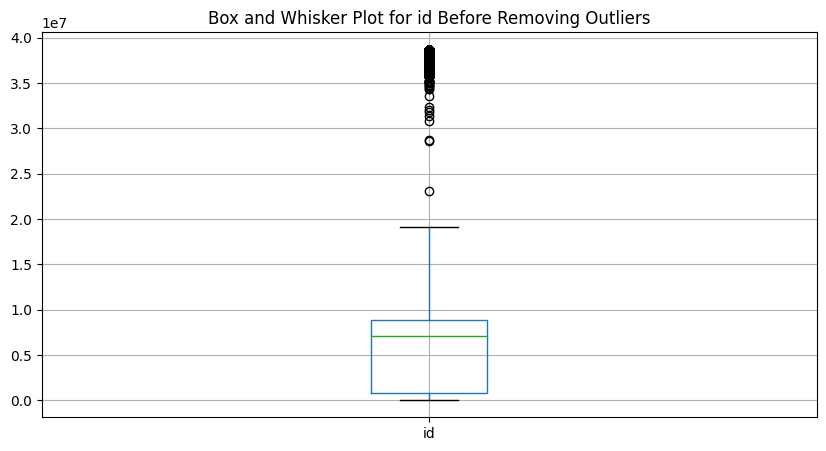

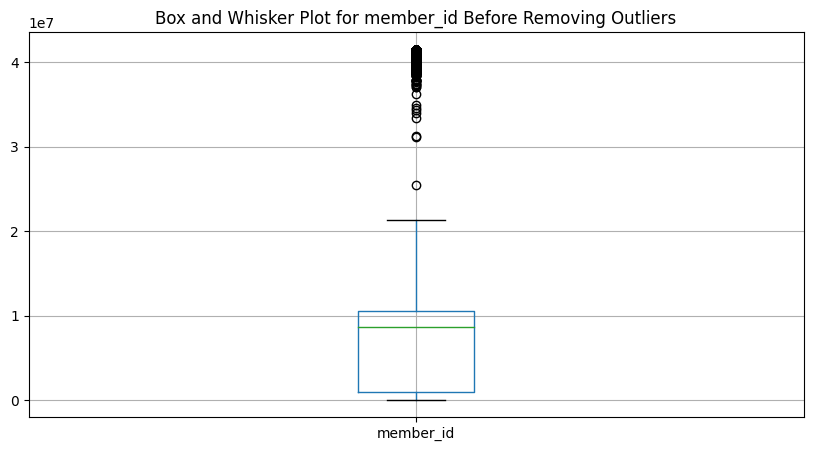

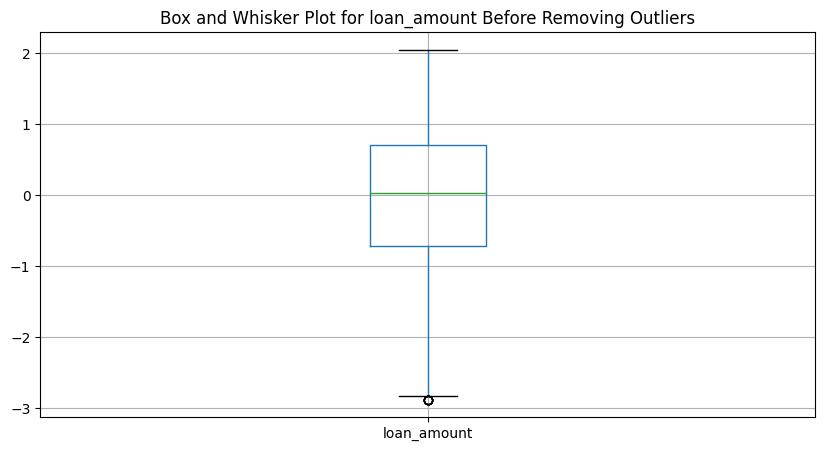

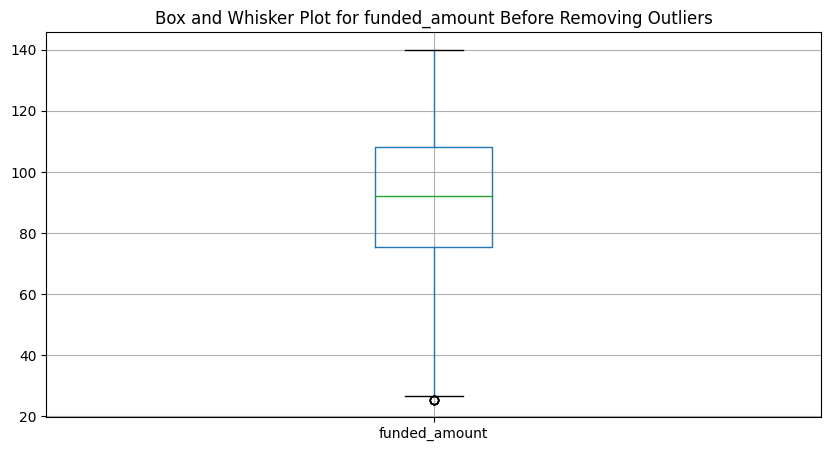

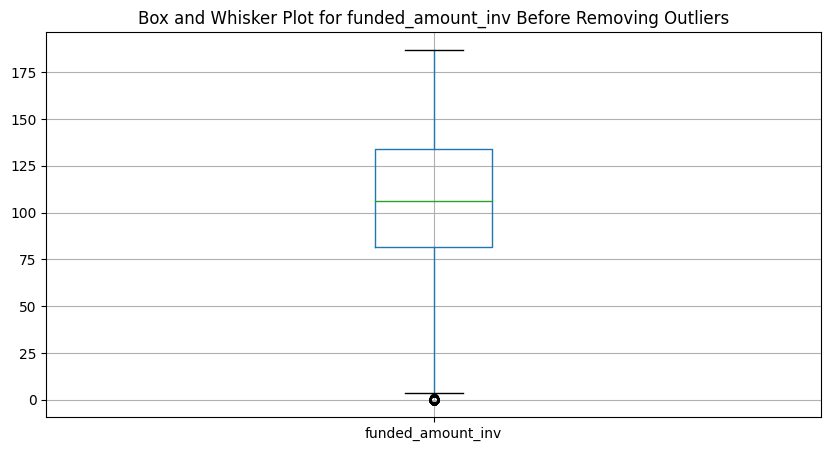

...

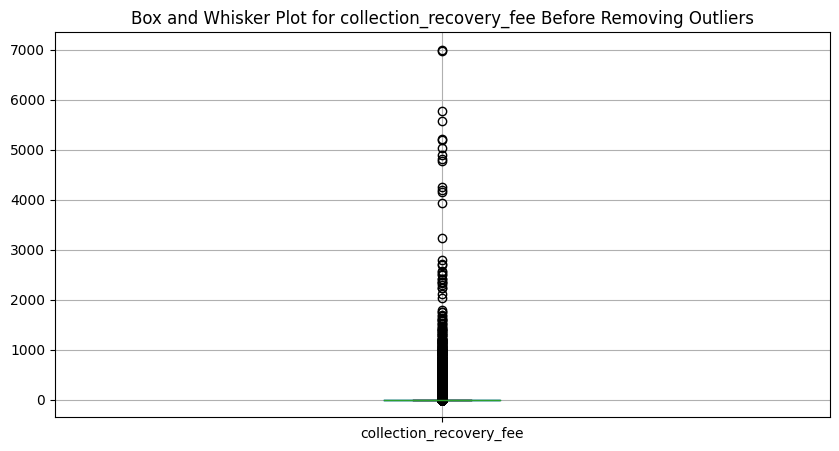

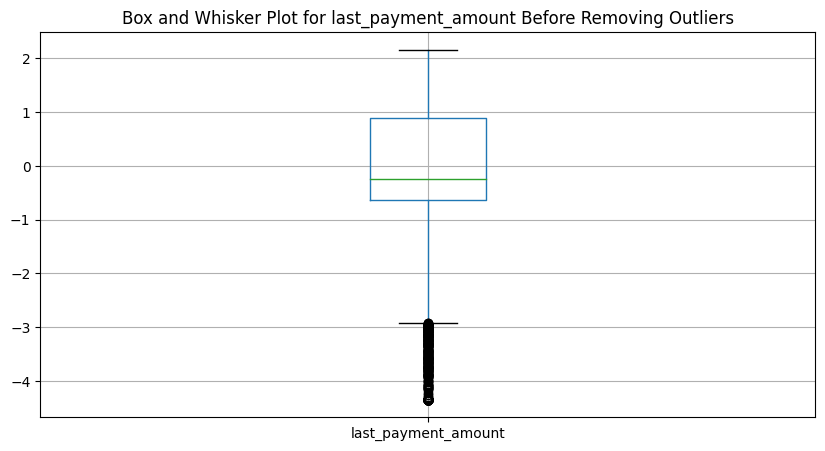

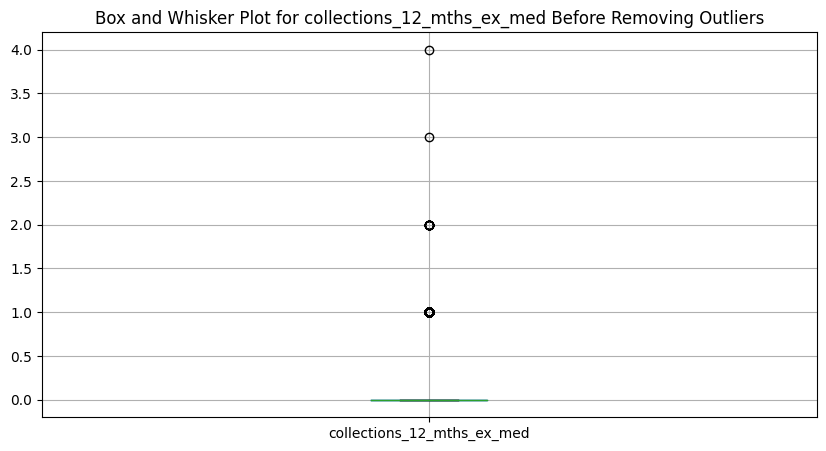

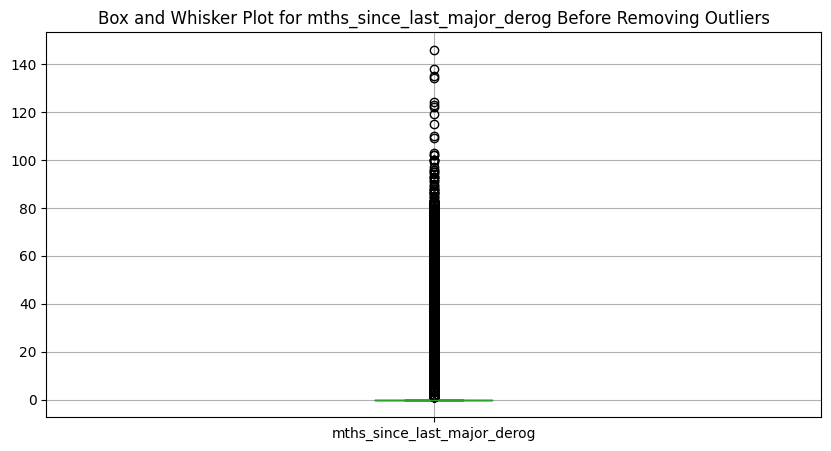

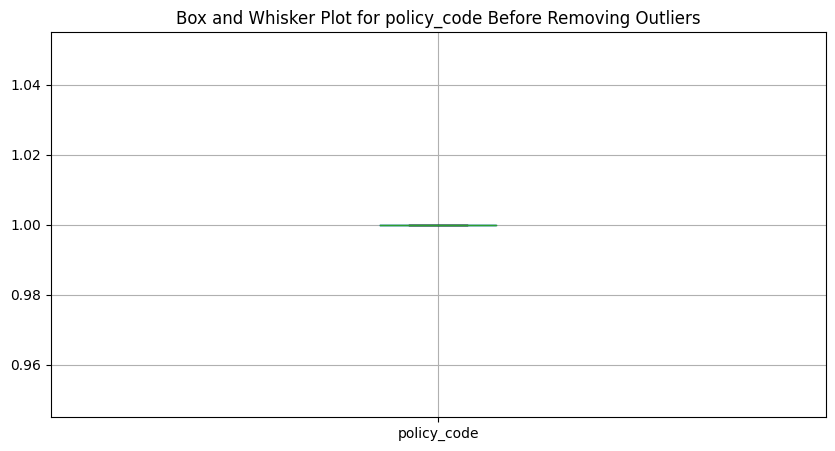

In [6]:
# Instantiate the Plotter class
plotter = Plotter(df)

# Define columns you want to visualize for outliers
numerical_df = df.select_dtypes(include=['number'])

# Plot the box and whisker plots for the specified columns before removing outliers
print("\nVisualizing outliers before removal...")
plotter.plot_box_plots(numerical_df, title_prefix="Before Removing Outliers")

# Plot the box and whisker plots using matplotlib for each column separately
print("\nVisualizing outliers with matplotlib before removal...")
for column in numerical_df.columns:
    plt.figure(figsize=(10, 5))
    df.boxplot(column=column)
    plt.title(f"Box and Whisker Plot for {column} Before Removing Outliers")
    plt.show()


### Pre-Transformation Analysis:

1. **Highly Skewed Variables**:
   - `annual_inc`: Extreme right skew with many outliers
   - `total_rec_late_fee`: Many zeros with sparse high values
   - `loan_amount`: Moderate right skew

2. **Outlier Patterns**:
   - Financial amounts show consistent right-skewed patterns
   - Payment-related variables have clustered outliers
   - Income-related features show extreme outliers